In [1]:
import matplotlib.pyplot as plt  # For visualizing images and data plots
import pandas as pd             # For data manipulation and analysis
import numpy as np              # For numerical computations
import cv2                      # For image processing
import os                       # For file and directory operations
import PIL                      # For handling image files
import tensorflow as tf         # TensorFlow library for building ML models
import tf_keras                 # Keras interface in TensorFlow (alternative import)
import tensorflow_hub as hub    # For using pre-trained models from TensorFlow Hub

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

In [2]:
import warnings
warnings.filterwarnings("ignore")  # Suppress warnings for cleaner output

In [3]:
# Define the directory where the image classification data is stored

data_dir = "C:\\Users\\mvenu\\OneDrive\\Desktop\\image_classification"  # Use double backslashes for Windows file paths

In [4]:
# Import the pathlib module for working with file paths in an object-oriented way
import pathlib

# Convert the string path into a Path object for easier manipulation and compatibility
data_dir = pathlib.Path(data_dir)

# Output the Path object to check or confirm the path
data_dir

WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification')

In [5]:
# List all the files and directories in the specified path (data_dir)

os.listdir(data_dir)  # Returns a list of the names of files and directories in the 'data_dir' folder

['Kane Williamson',
 'Kobe Bryant',
 'lionel_messi',
 'Maria Sharapova',
 'ms_dhoni',
 'neeraj_chopra']

In [6]:
list(data_dir.glob('*/*.jpg'))[:5] # List all .jpg files in subdirectories of 'data_dir'
                                   #[:5]   Display the first 5 .jpg files found

[WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (1).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (10).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (100).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (101).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (102).jpg')]

In [7]:
image_count = len(list(data_dir.glob('*/*.jpg')))  # Count the number of .jpg files in subdirectories of 'data_dir'
print(image_count)  # Print the total count of .jpg files

608


In [8]:
kane = list(data_dir.glob('Kane Williamson/*'))  # List all files in the 'Kane Williamson' subdirectory of 'data_dir'
kane[:5]  # Display the first 5 files found in the 'Kane Williamson' directory

[WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (1).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (10).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (100).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (101).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (102).jpg')]

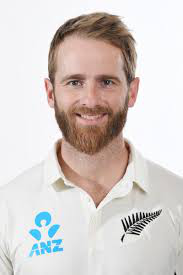

In [9]:
PIL.Image.open(str(kane[0]))  # Open the first image file from the 'Kane Williamson' directory using PIL

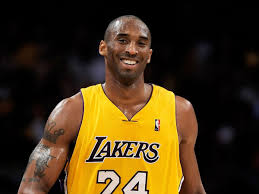

In [10]:
Kobe_Bryant = list(data_dir.glob('Kobe Bryant/*'))  # List all files in the 'Kobe Bryant' subdirectory of 'data_dir'
PIL.Image.open(str(Kobe_Bryant[5]))  # Open the 6th image file from the 'Kobe Bryant' directory using PIL (index starts from 0)

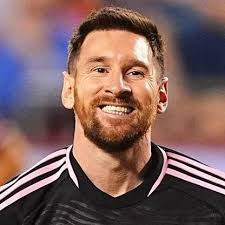

In [11]:
lionel_messi = list(data_dir.glob('lionel_messi/*'))  # List all files in the 'lionel_messi' subdirectory of 'data_dir'
PIL.Image.open(str(lionel_messi[5]))  # Open the 6th image file from the 'lionel_messi' directory using PIL (index starts from 0)

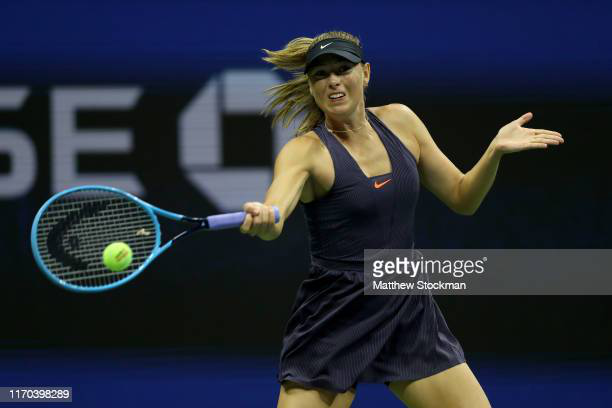

In [12]:
Maria_Sharapova = list(data_dir.glob('Maria Sharapova/*'))  # List all files in the 'Maria Sharapova' subdirectory of 'data_dir'
PIL.Image.open(str(Maria_Sharapova[5]))  # Open the 6th image file from the 'Maria Sharapova' directory using PIL (index starts from 0)

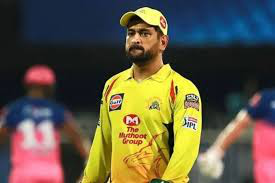

In [13]:
ms_dhoni = list(data_dir.glob('ms_dhoni/*'))  # List all files in the 'ms_dhoni' subdirectory of 'data_dir'
PIL.Image.open(str(ms_dhoni[5]))  # Open the 6th image file from the 'ms_dhoni' directory using PIL (index starts from 0)

In [14]:
# Create a dictionary to store lists of image files for different sports celebrities
sports_celebrity_images_dict = {
    'kane': list(data_dir.glob('Kane Williamson/*')),  # List all files in the 'Kane Williamson' subdirectory
    'Kobe_Bryant': list(data_dir.glob('Kobe Bryant/*')),  # List all files in the 'Kobe Bryant' subdirectory
    'lionel_messi': list(data_dir.glob('lionel_messi/*')),  # List all files in the 'lionel_messi' subdirectory
    'Maria_Sharapova': list(data_dir.glob('Maria Sharapova/*')),  # List all files in the 'Maria Sharapova' subdirectory
    'ms_dhoni': list(data_dir.glob('ms_dhoni/*')),  # List all files in the 'ms_dhoni' subdirectory
    'neeraj_chopra': list(data_dir.glob('neeraj_chopra/*')),  # List all files in the 'neeraj_chopra' subdirectory
}

In [15]:
# Create a dictionary to map sports celebrity names to numerical labels
sports_celebrity_labels_dict = {
    'kane': 0,  # Label 0 for 'Kane Williamson'
    'Kobe_Bryant': 1,  # Label 1 for 'Kobe Bryant'
    'lionel_messi': 2,  # Label 2 for 'Lionel Messi'
    'Maria_Sharapova': 3,  # Label 3 for 'Maria Sharapova'
    'ms_dhoni': 4,  # Label 4 for 'MS Dhoni'
    'neeraj_chopra': 5  # Label 5 for 'Neeraj Chopra'
}

In [16]:
sports_celebrity_images_dict['kane'][:5]  # Display the first 5 image files for 'Kane Williamson'


[WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (1).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (10).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (100).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (101).jpg'),
 WindowsPath('C:/Users/mvenu/OneDrive/Desktop/image_classification/Kane Williamson/images (102).jpg')]

In [17]:
str(sports_celebrity_images_dict['kane'][0])  # Convert the first image path for 'Kane Williamson' to a string

'C:\\Users\\mvenu\\OneDrive\\Desktop\\image_classification\\Kane Williamson\\images (1).jpg'

In [18]:
img = cv2.imread(str(sports_celebrity_images_dict['kane'][0]))  # Read the first image for 'Kane Williamson' using OpenCV

In [19]:
img.shape  # Get the dimensions (height, width, channels) of the loaded image

(275, 183, 3)

In [20]:
cv2.resize(img, (224, 224)).shape  # Resize the image to 224x224 and get its new dimensions

(224, 224, 3)

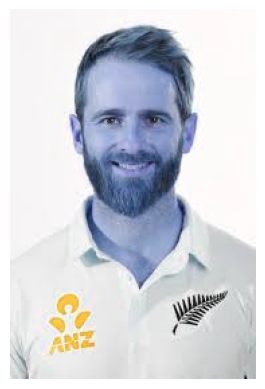

In [21]:
plt.axis('off')  # Turn off the axis for the image display
plt.imshow(img)  # Display the image using Matplotlib

In [22]:
X, y = [], []  # Initialize empty lists to store image data (X) and labels (y)

# Loop through each sports celebrity and their associated images
for sports_celebrity_name, images in sports_celebrity_images_dict.items():
    for image in images:
        img = cv2.imread(str(image))  # Read the image from the file path
        resized_img = cv2.resize(img, (224, 224))  # Resize the image to 224x224 pixels
        X.append(resized_img)  # Add the resized image to the 'X' list (features)
        y.append(sports_celebrity_labels_dict[sports_celebrity_name])  # Add the corresponding label to the 'y' list (targets)

In [23]:
X = np.array(X)  # Convert the list of images (X) into a NumPy array
y = np.array(y)  # Convert the list of labels (y) into a NumPy array

In [24]:
# Import train_test_split from sklearn to split the dataset into training and testing sets
from sklearn.model_selection import train_test_split

# Split the data (X) and labels (y) into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)  # Use random_state=0 for reproducibility

In [25]:
# Preprocessing: Scale images by normalizing pixel values to the range [0, 1]
X_train_scaled = X_train / 255  # Normalize the training images by dividing by 255
X_test_scaled = X_test / 255  # Normalize the testing images by dividing by 255

In [26]:
# Define the number of output classes (sports celebrities)
num_classes = 6

# Build the convolutional neural network (CNN) model using Keras Sequential API
cnn_model = Sequential([
  layers.Conv2D(16, 3, padding='same', activation='relu'),  # Convolutional layer with 16 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Conv2D(32, 3, padding='same', activation='relu'),  # Convolutional layer with 32 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Conv2D(64, 3, padding='same', activation='relu'),  # Convolutional layer with 64 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Conv2D(128, 3, padding='same', activation='relu'),  # Convolutional layer with 128 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Flatten(),  # Flatten the 3D output to 1D for the dense layer
  layers.Dense(128, activation='relu'),  # Fully connected layer with 128 units and ReLU activation
  layers.Dense(num_classes)  # Output layer with 'num_classes' units (6 in this case)
])

# Compile the CNN model with the Adam optimizer and sparse categorical crossentropy loss
cnn_model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),  # Loss function for multi-class classification
              metrics=['accuracy'])  # Track accuracy during training

# Train the CNN model for 15 epochs using the training data
cnn_model.fit(X_train_scaled, y_train, epochs=15)  # Fit the model to the training data

Epoch 1/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 174ms/step - accuracy: 0.2049 - loss: 1.9623
Epoch 2/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 147ms/step - accuracy: 0.3621 - loss: 1.6611
Epoch 3/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 147ms/step - accuracy: 0.4699 - loss: 1.4220
Epoch 4/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 146ms/step - accuracy: 0.5363 - loss: 1.2707
Epoch 5/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 146ms/step - accuracy: 0.6293 - loss: 1.0344
Epoch 6/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 148ms/step - accuracy: 0.6602 - loss: 0.9509
Epoch 7/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 148ms/step - accuracy: 0.7305 - loss: 0.7576
Epoch 8/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 148ms/step - accuracy: 0.8497 - loss: 0.4335
Epoch 9/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 150ms/step - accuracy: 0.9327 - loss: 0.2139
Epoch 10/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 150ms/step - accuracy: 0.9744 - loss: 0.1128
Epoch 11/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 150ms/step - accuracy: 0.9685 - loss: 0.1044
Epoch 12/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 150ms/step

In [27]:
cnn_model.evaluate(X_test_scaled, y_test)  # Evaluate the trained CNN model on the test data

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.5348 - loss: 3.5032


[3.2107460498809814, 0.5263158082962036]

In [28]:
y_pred = cnn_model.predict(X_test_scaled)  # Use the CNN model to make predictions on the test data

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


In [29]:
score = tf.nn.softmax(y_pred[0])  # Apply the softmax function to the first prediction to get class probabilities

In [30]:
np.argmax(score)  # Get the index of the highest probability in the score array (predicted class)

5

In [31]:
y_test[0]  # Retrieve the true label for the first test sample

5

In [32]:
# Define a Sequential model for data augmentation using Keras layers
data_augmentation = tf.keras.Sequential(
  [
    layers.RandomFlip("horizontal", input_shape=(224, 224, 3)),  # Randomly flip images horizontally
    layers.RandomRotation(0.2),  # Randomly rotate images by up to 20%
    layers.RandomZoom(0.2),  # Randomly zoom images by up to 20%
    layers.RandomContrast(0.3),  # Randomly adjust contrast of images by up to 30%
  ]
)

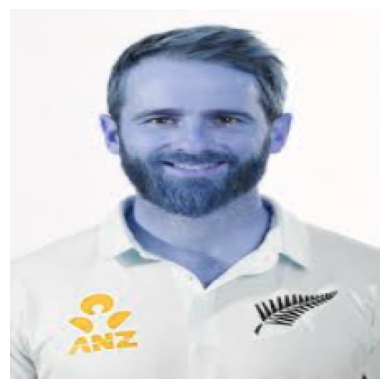

In [33]:
# Display the original image (first image in the dataset)
plt.axis('off')  # Turn off axis labels and ticks for better visualization
plt.imshow(X[0])  # Show the first image from the dataset (X)

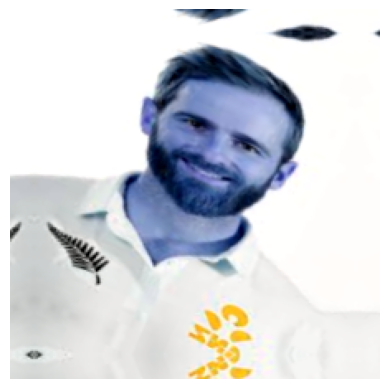

In [34]:
# Display the augmented version of the first image in the dataset
plt.axis('off')  # Turn off axis labels and ticks for better visualization
plt.imshow(data_augmentation(X)[0].numpy().astype("uint8"))  # Apply data augmentation and display the first augmented image

In [35]:
# Define the number of output classes (sports celebrities)
num_classes = 6

# Build a CNN model with data augmentation and a dropout layer to improve generalization
DA_model = Sequential([
  data_augmentation,  # Apply data augmentation to input images
  layers.Conv2D(16, 3, padding='same', activation='relu'),  # Convolutional layer with 16 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Conv2D(32, 3, padding='same', activation='relu'),  # Convolutional layer with 32 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Conv2D(64, 3, padding='same', activation='relu'),  # Convolutional layer with 64 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Conv2D(128, 3, padding='same', activation='relu'),  # Convolutional layer with 128 filters, 3x3 kernel, and ReLU activation
  layers.MaxPooling2D(),  # MaxPooling layer to reduce spatial dimensions
  layers.Dense(128, activation='relu'),  # Fully connected layer with 128 units and ReLU activation
  layers.Dropout(0.3),  # Dropout layer with a dropout rate of 30% to prevent overfitting
  layers.Flatten(),  # Flatten the 3D feature maps into a 1D vector
  layers.Dense(num_classes, activation='softmax')  # Output layer with softmax activation for multi-class classification
])

# Compile the CNN model with the Adam optimizer and sparse categorical crossentropy loss
DA_model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),  # Loss function for multi-class classification
              metrics=['accuracy'])  # Track accuracy during training

# Train the CNN model with the augmented data for 20 epochs
DA_model.fit(X_train_scaled, y_train, epochs=20)  # Fit the model to the training data

Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 229ms/step - accuracy: 0.2181 - loss: 1.7584
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 186ms/step - accuracy: 0.2648 - loss: 1.7002
Epoch 3/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 198ms/step - accuracy: 0.3430 - loss: 1.6387
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 199ms/step - accuracy: 0.3268 - loss: 1.6160
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 198ms/step - accuracy: 0.3830 - loss: 1.5742
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 205ms/step - accuracy: 0.3929 - loss: 1.5076
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 194ms/step - accuracy: 0.4656 - loss: 1.4355
Epoch 8/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 195ms/step - accuracy: 0.4243 - loss: 1.4197
Epoch 9/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 196ms/step - accuracy: 0.4022 - loss: 1.4319
Epoch 10/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 190ms/step - accuracy: 0.4990 - loss: 1.3211
Epoch 11/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 184ms/step - accuracy: 0.5342 - loss: 1.2857
Epoch 12/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 181ms/step

In [36]:
DA_model.evaluate(X_test_scaled, y_test)  # Evaluate the model with data augmentation on the test dataset

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - accuracy: 0.5262 - loss: 1.2282


[1.1475368738174438, 0.5526315569877625]

In [37]:
# Set the image shape for input to the classifier
image_shape = (224, 224)

# Define a Sequential model with a pre-trained MobileNet V2 classifier
classifier = tf_keras.Sequential([
    hub.KerasLayer(
        "https://www.kaggle.com/models/google/mobilenet-v2/TensorFlow2/tf2-preview-classification/4",  # URL for the pre-trained MobileNet V2 model
        input_shape=image_shape + (3,)  # Specify the input shape (224x224x3 for RGB images)
    )
])

In [38]:
X[0].shape  # Check the shape of the first image in the dataset (X) to confirm it matches the input requirements

(224, 224, 3)

In [39]:
image_shape + (3,)  # Append the number of color channels (3 for RGB) to the image shape

(224, 224, 3)

In [40]:
# Resize the first image in the dataset to match the expected input shape
x0_resized = cv2.resize(X[0], image_shape)  # Resize X[0] to (224, 224)

# Resize the second image in the dataset to match the expected input shape
x1_resized = cv2.resize(X[1], image_shape)  # Resize X[1] to (224, 224)

# Resize the third image in the dataset to match the expected input shape
x2_resized = cv2.resize(X[2], image_shape)  # Resize X[2] to (224, 224)

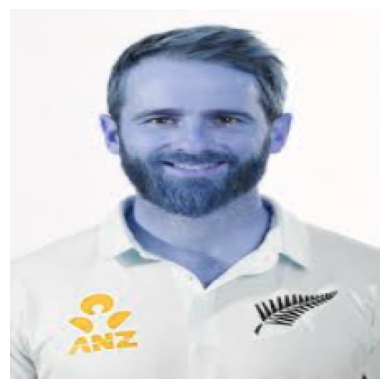

In [41]:
plt.axis('off')  # Disable axis labels and ticks for a cleaner image display
plt.imshow(X[0])  # Display the first image in the dataset (X[0]) using Matplotlib

In [42]:
# Use the pre-trained classifier to make predictions on the resized images
predicted = classifier.predict(np.array([x0_resized, x1_resized, x2_resized]))  

# Get the index of the highest probability for each prediction (corresponding to the predicted class)
predicted = np.argmax(predicted, axis=1)  

# Display the predicted class indices
predicted  

1/1 [==============================] - 5s 5s/step


array([722, 795, 795], dtype=int64)

In [43]:
# Load the pre-trained MobileNetV2 model without the top classification layer
base_model = MobileNetV2(weights="imagenet", include_top=False, input_shape=(224, 224, 3))  

# Freeze the base model to prevent its weights from being updated during training
base_model.trainable = False  

In [44]:
# Set the number of classes for the classification task
num_of_sports_celebrity = 6  # Number of unique sports celebrities (6 classes)

# Define the model architecture using the pre-trained base model
mobilenet_model = Sequential([
    base_model,  # Add the frozen MobileNetV2 base model
    GlobalAveragePooling2D(),  # Add global average pooling to reduce dimensions
    Dense(num_of_sports_celebrity)  # Output layer with logits (no activation applied yet)
])

# Display a summary of the model architecture
mobilenet_model.summary()  # Provides details about each layer, parameters, and total trainable parameters

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224 (Functional)    │ (None, 7, 7, 1280)          │       2,257,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 1280)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 6)                   │           7,686 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,265,670 (8.64 MB)

 Trainable params: 7,686 (30.02 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [45]:
# Compile the MobileNetV2 model with the Adam optimizer and Sparse Categorical Crossentropy loss function
mobilenet_model.compile(
    optimizer="adam",  # Optimizer for model training
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),  # Loss function for multi-class classification
    metrics=['accuracy']  # Metrics to track during training (accuracy)
)

# Preprocess the training and test data using MobileNetV2's preprocessing function
X_train_scaled = preprocess_input(X_train)  # Preprocess the training images
X_test_scaled = preprocess_input(X_test)  # Preprocess the test images

# Train the model with the preprocessed data for 15 epochs
mobilenet_model.fit(X_train_scaled, y_train, epochs=15)  # Train the model with training data


Epoch 1/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 455ms/step - accuracy: 0.2861 - loss: 1.8057
Epoch 2/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 416ms/step - accuracy: 0.5406 - loss: 1.2406
Epoch 3/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 404ms/step - accuracy: 0.6974 - loss: 0.9205
Epoch 4/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 393ms/step - accuracy: 0.8185 - loss: 0.6783
Epoch 5/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 419ms/step - accuracy: 0.8892 - loss: 0.5681
Epoch 6/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 446ms/step - accuracy: 0.8963 - loss: 0.4953
Epoch 7/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 421ms/step - accuracy: 0.9259 - loss: 0.4233
Epoch 8/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 405ms/step - accuracy: 0.9374 - loss: 0.3698
Epoch 9/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 390ms/step - accuracy: 0.9459 - loss: 0.3246
Epoch 10/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 381ms/step - accuracy: 0.9704 - loss: 0.2886
Epoch 11/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 367ms/step - accuracy: 0.9793 - loss: 0.2513
Epoch 12/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 377ms/ste

In [46]:
# Evaluate the trained MobileNetV2 model on the test data to check its performance
mobilenet_model.evaluate(X_test_scaled, y_test)  # Returns loss and accuracy on the test set

5/5 ━━━━━━━━━━━━━━━━━━━━ 3s 377ms/step - accuracy: 0.8280 - loss: 0.6074


[0.5379944443702698, 0.8486841917037964]

In [47]:
y_pred = mobilenet_model.predict(X_test_scaled)  # Predict class probabilities for the test data
y_pred = [np.argmax(i) for i in y_pred]  # Convert probabilities to class labels by selecting the highest probability

5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 685ms/step


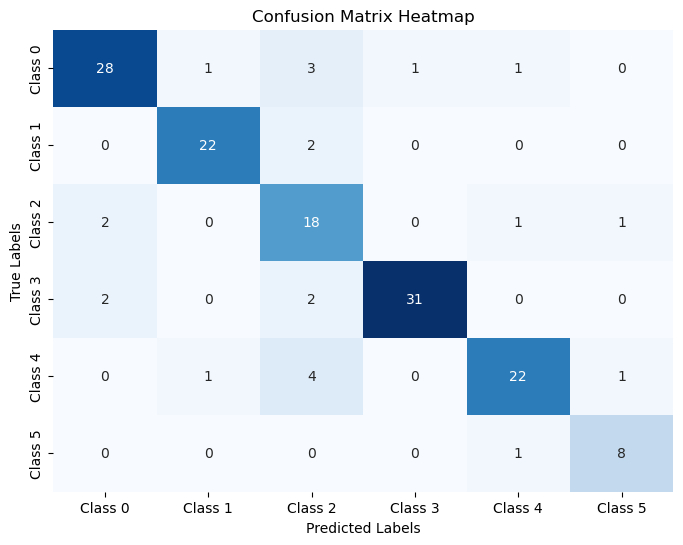

In [48]:
import seaborn as sns  # Import seaborn for visualizing data
from sklearn.metrics import confusion_matrix, classification_report  # Import evaluation metrics
# Generate the confusion matrix
cm = confusion_matrix(y_test, y_pred)  # Compute confusion matrix

# Create a heatmap for the confusion matrix
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[f'Class {i}' for i in range(len(cm))],
            yticklabels=[f'Class {i}' for i in range(len(cm))], cbar=False)  # Create the heatmap
plt.title('Confusion Matrix Heatmap')  # Add title to the heatmap
plt.xlabel('Predicted Labels')  # X-axis label
plt.ylabel('True Labels')  # Y-axis label
plt.show()  # Display the heatmap

In [49]:
print(classification_report(y_test, y_pred))  # Print precision, recall, F1-score, and support for each class

              precision    recall  f1-score   support

           0       0.88      0.82      0.85        34
           1       0.92      0.92      0.92        24
           2       0.62      0.82      0.71        22
           3       0.97      0.89      0.93        35
           4       0.88      0.79      0.83        28
           5       0.80      0.89      0.84         9

    accuracy                           0.85       152
   macro avg       0.84      0.85      0.84       152
weighted avg       0.86      0.85      0.85       152



In [50]:
# Load the ResNet50V2 model pre-trained on ImageNet without the top classification layer
base_model = ResNet50V2(weights="imagenet", include_top=False, input_shape=(224, 224, 3))

# Freeze the base model layers to retain pre-trained weights during transfer learning
base_model.trainable = False

In [51]:
# Define a new model with ResNet50V2 as the base and additional classification layers
num_of_sports_celebrity = 6  # Specify the number of classes (6 celebrities)

# Build the model architecture
resnet_model = Sequential([
    base_model,  # Add the pre-trained ResNet50V2 base model
    GlobalAveragePooling2D(),  # Add global average pooling to reduce dimensions
    Dense(num_of_sports_celebrity)  # Add a dense layer for class logits (no activation)
])

# Display the model summary to review its structure
resnet_model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ resnet50v2 (Functional)              │ (None, 7, 7, 2048)          │      23,564,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_1           │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 6)                   │          12,294 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 23,577,094 (89.94 MB)

 Trainable params: 12,294 (48.02 KB)

 Non-trainable params: 23,564,800 (89.89 MB)

In [52]:
# Compile the ResNet50V2 model with Adam optimizer, sparse categorical crossentropy loss, and accuracy metric
resnet_model.compile(
    optimizer="adam",  # Use Adam optimizer for efficient training
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),  # Specify loss function for multi-class classification
    metrics=['accuracy']  # Evaluate model performance using accuracy
)

# Preprocess training and testing data with ResNet50V2-specific preprocessing
X_train_scaled = preprocess_input(X_train)  # Apply preprocessing to training data
X_test_scaled = preprocess_input(X_test)  # Apply preprocessing to testing data

# Train the ResNet50V2 model for 15 epochs
resnet_model.fit(X_train_scaled, y_train, epochs=15)  # Fit the model with training data and labels

Epoch 1/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 20s 920ms/step - accuracy: 0.2763 - loss: 1.9506
Epoch 2/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 15s 986ms/step - accuracy: 0.5799 - loss: 1.1530
Epoch 3/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 14s 915ms/step - accuracy: 0.7413 - loss: 0.7889
Epoch 4/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 865ms/step - accuracy: 0.8602 - loss: 0.5928
Epoch 5/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 844ms/step - accuracy: 0.9156 - loss: 0.4602
Epoch 6/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 863ms/step - accuracy: 0.9336 - loss: 0.3518
Epoch 7/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 14s 929ms/step - accuracy: 0.9552 - loss: 0.3113
Epoch 8/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 14s 944ms/step - accuracy: 0.9740 - loss: 0.2556
Epoch 9/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 851ms/step - accuracy: 0.9869 - loss: 0.2049
Epoch 10/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 14s 912ms/step - accuracy: 0.9827 - loss: 0.2112
Epoch 11/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 14s 892ms/step - accuracy: 0.9894 - loss: 0.1737
Epoch 12/15
15/15 ━━━━━━━━━━━━━━━━━━━━ 14

In [53]:
# Evaluate the trained ResNet50V2 model on the test data
resnet_model.evaluate(X_test_scaled, y_test)  # Outputs loss and accuracy on the test dataset

5/5 ━━━━━━━━━━━━━━━━━━━━ 6s 881ms/step - accuracy: 0.8288 - loss: 0.6381


[0.5913101434707642, 0.8289473652839661]

In [54]:
y_pred = resnet_model.predict(X_test_scaled)  # Predict class probabilities for test data
y_pred = [np.argmax(i) for i in y_pred]  # Convert probabilities to class labels

4/5 ━━━━━━━━━━━━━━━━━━━━ 0s 955ms/stepWARNING:tensorflow:5 out of the last 11 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x000002C1443E37E0> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


5/5 ━━━━━━━━━━━━━━━━━━━━ 7s 1s/step  


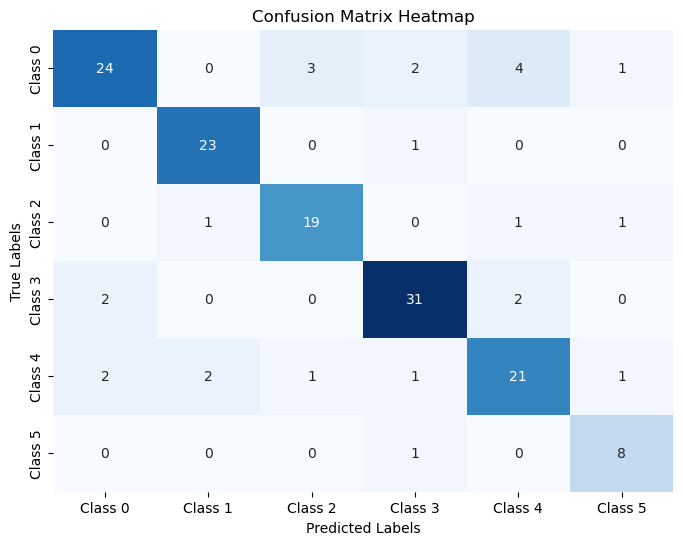

In [55]:
import seaborn as sns  # Import seaborn for visualizing data
from sklearn.metrics import confusion_matrix, classification_report  # Import evaluation metrics
# Generate the confusion matrix
cm = confusion_matrix(y_test, y_pred)  # Compute confusion matrix

# Create a heatmap for the confusion matrix
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[f'Class {i}' for i in range(len(cm))],
            yticklabels=[f'Class {i}' for i in range(len(cm))], cbar=False)  # Create the heatmap
plt.title('Confusion Matrix Heatmap')  # Add title to the heatmap
plt.xlabel('Predicted Labels')  # X-axis label
plt.ylabel('True Labels')  # Y-axis label
plt.show()  # Display the heatmap

In [56]:
print(classification_report(y_test, y_pred))  # Print precision, recall, F1-score, and support for each class

              precision    recall  f1-score   support

           0       0.86      0.71      0.77        34
           1       0.88      0.96      0.92        24
           2       0.83      0.86      0.84        22
           3       0.86      0.89      0.87        35
           4       0.75      0.75      0.75        28
           5       0.73      0.89      0.80         9

    accuracy                           0.83       152
   macro avg       0.82      0.84      0.83       152
weighted avg       0.83      0.83      0.83       152



In [57]:
# Define the labels for the classes
labels = ["Kane Williamson", "Kobe Bryant", "lionel_messi", "Maria Sharapova", "ms_dhoni", "neeraj_chopra"]  # Class names

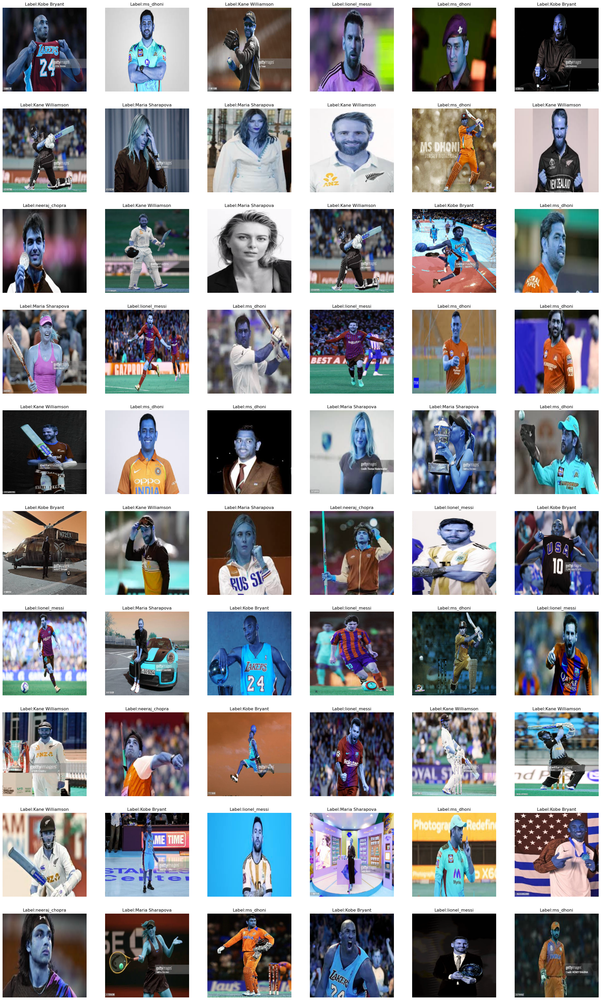

In [58]:
# Plot images from the training set with their corresponding labels
plt.figure(figsize=(30, 50))  # Set the figure size for the grid of images

# Loop through the first 60 images in the training dataset
for i in range(60):
    plt.subplot(10, 6, i + 1)  # Create a subplot with 10 rows and 6 columns
    plt.imshow(X_train[i])  # Display the image
    plt.title(f"Label:{labels[y_train[i]]}")  # Set the title to display the corresponding label
    plt.axis("off")  # Turn off the axis for cleaner visualization

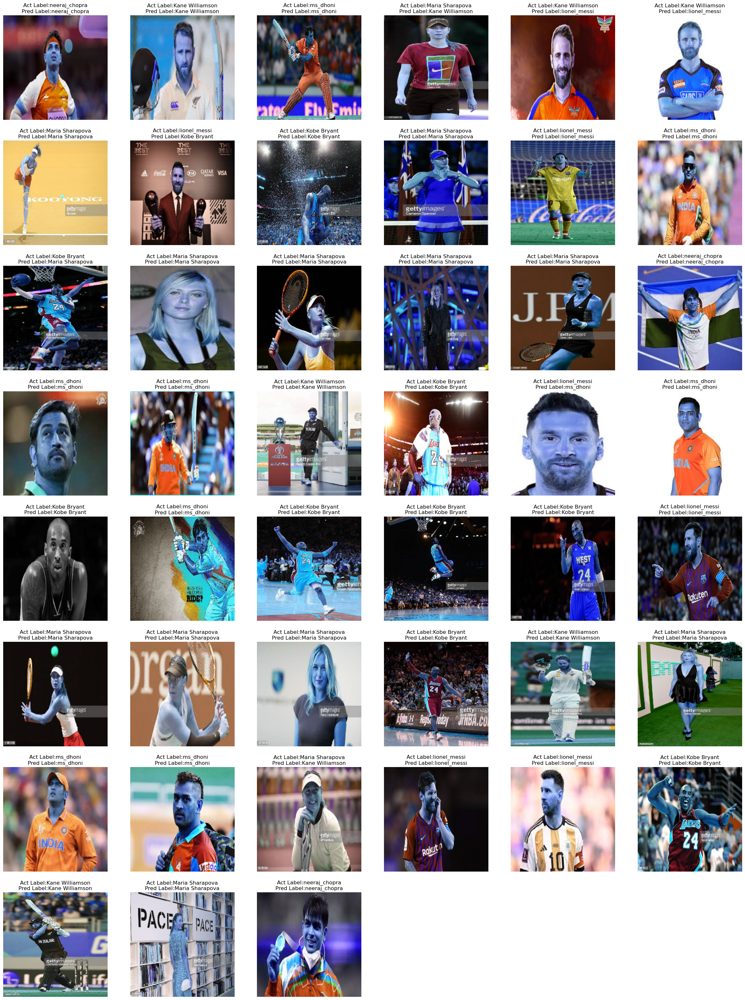

In [59]:
# Plot images from the test set along with actual and predicted labels
plt.figure(figsize=(30, 40))  # Set the figure size for the grid of images

# Loop through the first 45 images in the test dataset
for i in range(45):
    plt.subplot(8, 6, i + 1)  # Create a subplot with 8 rows and 6 columns
    plt.imshow(X_test[i])  # Display the image
    plt.title(f"Act Label:{labels[y_test[i]]}\nPred Label:{labels[y_pred[i]]}")  # Display actual and predicted labels
    plt.axis("off")  # Turn off the axis for cleaner visualization

In [60]:
DA_model.save('app.h5')